# Case study: Online advertising

Find out which banner is the most effective and has the maximum **click-through-rate (CTR)**, which is defined as the total number of clicks an ad receives

In [1]:
import numpy as np
import pandas as pd

In [2]:
# Bernoulli bandits
class BernoulliBandit(object):
    def __init__(self, p) -> None:
        self.p = p
    
    def display_ad(self):
        """
        Display the ad based on the Bernoulli distribution
        """
        reward = np.random.binomial(n=1, p=self.p)
        return reward

In [3]:
p_values = [0.004, 0.016, 0.02, 0.028, 0.031]
ads = [BernoulliBandit(p) for p in p_values]

In [4]:
np.argmax(p_values)

4

Average reward observed prior to the $n^{th}$ selection
$$Q_n = \frac{R_1+R_2+\cdots+R_{n-1}}{n-1} $$

Update the action values
$$ Q_{n+1} = Q_n + \frac{1}{n} (R_n - Q_n) $$
$$ Q_{n+1} = Q_n + \alpha (R_n - Q_n) $$

## A/B/n testing

In [5]:
num_ads = len(ads)
num_test = 10000
num_prod = 90000

In [6]:
Q = np.zeros(num_ads)
N = np.zeros(num_ads)
total_reward = 0
avg_rewards = []

for i in range(num_test):
    ad_chosen = np.random.randint(num_ads)
    R = ads[ad_chosen].display_ad() # observe reward
    N[ad_chosen] += 1
    alpha = 1 / N[ad_chosen]
    Q[ad_chosen] += alpha * (R - Q[ad_chosen])
    total_reward += R
    avg_reward_so_far = total_reward / (i + 1)
    avg_rewards.append(avg_reward_so_far)

In [7]:
ad_chosen_for_production = np.argmax(Q)
print(f"Ad chosen for production: {ad_chosen_for_production}")

Ad chosen for production: 3


In [8]:
# Use the chosen ad in the production environment
for i in range(num_prod):
    ad_chosen = ad_chosen_for_production
    R = ads[ad_chosen_for_production].display_ad()
    total_reward += R
    avg_reward_so_far = total_reward / (num_test + i + 1)
    avg_rewards.append(avg_reward_so_far)

In [9]:
avg_reward_so_far

0.02677

## Visualize the results

In [10]:
df_reward_comparision = pd.DataFrame(avg_rewards, columns=['A/B/n'])

In [11]:
import cufflinks as cf
import plotly.offline

In [12]:
cf.go_offline()
cf.set_config_file(world_readable=True, theme='white')

In [13]:
df_reward_comparision['A/B/n'].iplot(title="A/B/n Test Avg. Reward: {:.4f}".format(avg_reward_so_far), xTitle='Impression', yTitle='Avg. Reward')

# $\varepsilon$-greedy actions

In [14]:
eps = 0.01
Q = np.zeros(num_ads)
N = np.zeros(num_ads)
total_reward = 0
avg_rewards = []

In [15]:
for i in range(num_test+num_prod):
    # choose action
    if np.random.uniform() <= eps:
        ad_chosen = np.random.randint(num_ads)
    else:
        ad_chosen = np.argmax(Q)
    # get rewards
    R = ads[ad_chosen].display_ad()
    N[ad_chosen] += 1
    Q[ad_chosen] += 1 / N[ad_chosen] * (R - Q[ad_chosen])
    total_reward += R
    avg_reward_so_far = total_reward / (i + 1)
    avg_rewards.append(avg_reward_so_far)


In [16]:
np.argmax(Q)

4

In [17]:
df_reward_comparision[f"Epsilon greedy {eps}"] = avg_rewards

In [18]:
df_reward_comparision["Epsilon greedy 0.01"].iplot(title="Epsilon greedy", xTitle='Impression', yTitle='Avg. Reward')

# UCB method

In [19]:
num_prod = 100000
c = 0.1
ad_indices = np.array(range(num_ads))

N = np.zeros(num_ads)
Q = np.zeros(num_ads)
total_reward = 0
avg_rewards = []

In [20]:
for t in range(1, num_prod+1):
    if any(N == 0):
        ad_chosen = np.random.choice(ad_indices)
    else:
        uncertainty = np.sqrt(np.log(t) / N)
        ad_chosen = np.argmax(Q + c * uncertainty)
    R = ads[ad_chosen].display_ad()
    N[ad_chosen] += 1
    Q[ad_chosen] += 1 / N[ad_chosen] * (R - Q[ad_chosen])
    total_reward += R
    avg_reward_so_far = total_reward / t
    avg_rewards.append(avg_reward_so_far)


In [21]:
df_reward_comparision[f"UCB c={c}"] = avg_rewards

In [22]:
df_reward_comparision["UCB c=0.1"].iplot(title=f"UCB c={c}, avg. reward: {avg_reward_so_far}")

# Thompson (Posterior) sampling

* Goal of MAB problems: estimate the parameters of the reward distribution for each arm
* Measuring uncertainty about estimate is a good way to guide the exploration strategy
* Bayesian inference framework: starts with prior probability distribution for parameter $\theta$ and updates the prior as data becomes available
$$ p(\theta|X) = \frac{p(X|\theta) p(\theta)}{p(X)} $$
* $p(\theta)$: Prior distribution of parameter $\theta$, current hypothesis
* $X$: Represents data with which we obtain a posterior distribution $ p(\theta|X)$
* $p(X|\theta)$: Likelihood of observing X given the parameter 
* $p(X)$: = Evidence


### Application to the online advertising scenario

Beta distribution for the prior of the ad $k$ is given by
$$ p(\theta_k) = \frac{\Gamma(\alpha_k + \beta_k)}{\Gamma(\alpha_k) \Gamma(\beta_k)} \theta^{\alpha_k - 1} (1 - \theta_k)^{\beta_k - 1}

Update on observing reward:
$$ \alpha_k \leftarrow \alpha_k + R_t $$
$$ \beta_k \leftarrow \beta_k + 1 - R_t $$

### Implementation

In [23]:
n_prod = 100000
n_ads = len(ads)
alphas = np.ones(n_ads)
betas = np.ones(n_ads)
total_reward = 0
avg_rewards = []

In [24]:
for i in range(n_prod):
    theta_samples = [np.random.beta(alphas[k], betas[k]) for k in range(n_ads)]
    ad_chosen = np.argmax(theta_samples)
    # reward
    R = ads[ad_chosen].display_ad()
    # update posterior distribution
    alphas[ad_chosen] += R
    betas[ad_chosen] += 1 - R
    total_reward += R
    avg_reward_so_far = total_reward / (i + 1)
    avg_rewards.append(avg_reward_so_far)
df_reward_comparision["Thompson sampling"] = avg_rewards

In [25]:
df_reward_comparision.max()

A/B/n                  0.111111
Epsilon greedy 0.01    0.029038
UCB c=0.1              0.048387
Thompson sampling      0.033268
dtype: float64

In [26]:
df_reward_comparision["Thompson sampling"].iplot(title="Thompson sampling")

In [27]:
import seaborn as sns
from matplotlib import pyplot as plt

In [28]:
sns.set()

In [29]:
df_beta = pd.DataFrame()
for k in range(n_ads):
    df_beta[f"Theta for ad {k}"] = np.random.beta([alphas[k]], betas[k], 1000) 

In [30]:
df_beta.head(5)

,Theta for ad 0,Theta for ad 1,Theta for ad 2,Theta for ad 3,Theta for ad 4
0,0.005392,0.015390,0.004467,0.026315,0.030926
1,0.003696,0.020371,0.004964,0.024363,0.030373
2,0.013630,0.023477,0.002983,0.026669,0.032413
3,0.003114,0.020042,0.007035,0.031578,0.031815
4,0.009725,0.014118,0.009522,0.033958,0.031261


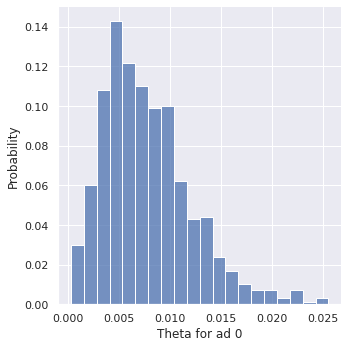

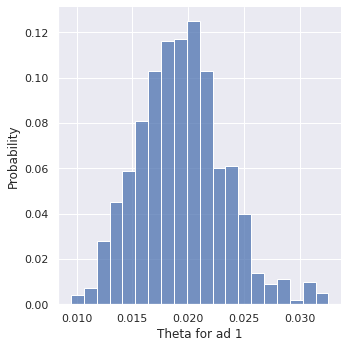

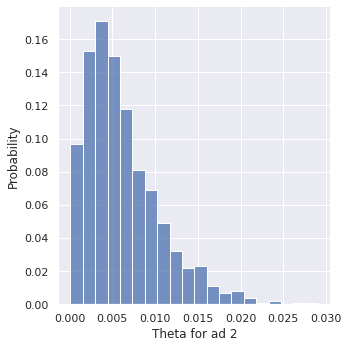

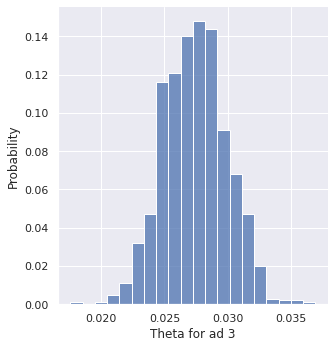

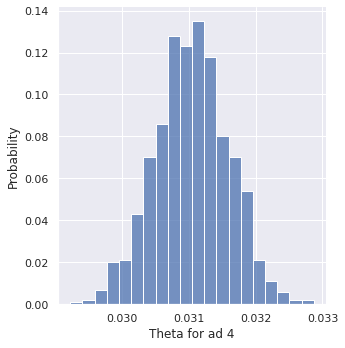

In [31]:
[sns.displot(data=df_beta, x=f'Theta for ad {k}', bins=20, stat='probability') for k in range(n_ads)]